# Final Project Submission

Please fill out:
* Student name: Kristin Cooper
* Student pace: Full Time
* Scheduled project review date/time: TBD
* Instructor name: James Irving
* Blog post URL: TBD


In [54]:
import pandas as pd
pd.set_option('display.max_columns', 0)
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('bmh') #try also seaborn-darkgrid, fivethirtyeight
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import os
import statsmodels
import math

import statsmodels.api as sm
import statsmodels.stats.api as sms
import statsmodels.formula.api as smf
from statsmodels.formula.api import ols
import scipy.stats as stats
from sklearn.linear_model import LinearRegression

# Obtain

* Understanding stakeholder requirements
    * King County homeowner interested in renovating their house in order to increase resale value
* Gathering information on the problem
* Sourcing data that we think will be necessary for solving this problem

In [2]:
df = pd.read_csv('data/kc_house_data.csv')
display(df.info())
display(df.head())
display(round(df.describe(),3))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

None

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.159700e+04,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,19221.000,21534.000,21597.000,21597.000,21597.000,21597.000,17755.000,21597.000,21597.000,21597.000,21597.00,21597.000
mean,4.580474e+09,540296.574,3.373,2.116,2080.322,15099.409,1.494,0.008,0.234,3.410,7.658,1788.597,1971.000,83.637,98077.952,47.560,-122.214,1986.62,12758.284
std,2.876736e+09,367368.140,0.926,0.769,918.106,41412.637,0.540,0.087,0.766,0.651,1.173,827.760,29.375,399.946,53.513,0.139,0.141,685.23,27274.442
min,1.000102e+06,78000.000,1.000,0.500,370.000,520.000,1.000,0.000,0.000,1.000,3.000,370.000,1900.000,0.000,98001.000,47.156,-122.519,399.00,651.000
25%,2.123049e+09,322000.000,3.000,1.750,1430.000,5040.000,1.000,0.000,0.000,3.000,7.000,1190.000,1951.000,0.000,98033.000,47.471,-122.328,1490.00,5100.000
50%,3.904930e+09,450000.000,3.000,2.250,1910.000,7618.000,1.500,0.000,0.000,3.000,7.000,1560.000,1975.000,0.000,98065.000,47.572,-122.231,1840.00,7620.000
75%,7.308900e+09,645000.000,4.000,2.500,2550.000,10685.000,2.000,0.000,0.000,4.000,8.000,2210.000,1997.000,0.000,98118.000,47.678,-122.125,2360.00,10083.000
max,9.900000e+09,7700000.000,33.000,8.000,13540.000,1651359.000,3.500,1.000,4.000,5.000,13.000,9410.000,2015.000,2015.000,98199.000,47.778,-121.315,6210.00,871200.000


# Scrub

Checklist:
1. Rename columns to be more intuitive
1. Feature engineering
1. Deal with data types
1. Removed null values
1. Deal with outliers

***
* Normalizing data (z-score)

In [3]:
# Rename columns to be more intuitive
df.rename(mapper={'date': 'date_sold', 
                  'sqft_living15': 'neighboring_sqft_living',
                  'sqft_lot15': 'neighboring_sqft_lot'}, axis=1, inplace=True)

In [4]:
# Create a column for Year Sold in order to calculate Age At Sale
df['year_sold'] = df['date_sold'].apply(lambda x: int(x[-4:]))
df['age_at_sale'] = df['year_sold'] - df['yr_built']

# Create a categorical column to indicate if a house was renovated or not
df['renovated?'] = np.where(df['yr_renovated']>0, 'Yes', 'No')
df.head()

df.head()

,id,date_sold,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,neighboring_sqft_living,neighboring_sqft_lot,year_sold,age_at_sale,renovated?
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,2014,59,No
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,2014,63,Yes
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,2015,82,No
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000,2014,49,No
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503,2015,28,No


In [5]:
# Create a column for Years Since Renovated for houses that have indeed been renovated
df_renovated = df.loc[df['renovated?'] == 'Yes']
df_renovated['yrs_since_renovated'] = df_renovated['year_sold'] - df_renovated['yr_renovated']
df['yrs_since_renovated'] = df_renovated['yrs_since_renovated']
df

<ipython-input-5-6d07e190143d>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_renovated['yrs_since_renovated'] = df_renovated['year_sold'] - df_renovated['yr_renovated']


,id,date_sold,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,neighboring_sqft_living,neighboring_sqft_lot,year_sold,age_at_sale,renovated?,yrs_since_renovated
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,2014,59,No,NaN
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,2014,63,Yes,23.0
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,2015,82,No,NaN
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000,2014,49,No,NaN
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503,2015,28,No,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,5/21/2014,360000.0,3,2.50,1530,1131,3.0,0.0,0.0,3,8,1530,0.0,2009,0.0,98103,47.6993,-122.346,1530,1509,2014,5,No,NaN
21593,6600060120,2/23/2015,400000.0,4,2.50,2310,5813,2.0,0.0,0.0,3,8,2310,0.0,2014,0.0,98146,47.5107,-122.362,1830,7200,2015,1,No,NaN
21594,1523300141,6/23/2014,402101.0,2,0.75,1020,1350,2.0,0.0,0.0,3,7,1020,0.0,2009,0.0,98144,47.5944,-122.299,1020,2007,2014,5,No,NaN
21595,291310100,1/16/2015,400000.0,3,2.50,1600,2388,2.0,NaN,0.0,3,8,1600,0.0,2004,0.0,98027,47.5345,-122.069,1410,1287,2015,11,No,NaN


In [6]:
# Converted date_sold column into datetime datatype to enable sorting
df['date_sold'] = pd.to_datetime(df['date_sold'])

# Converted zipcode into object so it isn't calculated mathematically
df['zipcode'] = df['zipcode'].astype(object)

In [7]:
# Found "?" value in sqft_basement column, keeping it from being stored as a float.
# reviewed the rows with "?" value, decided to replace the ? with nan for now and deal later
df.loc[df['sqft_basement']=='?'].drop(columns=['id', 'waterfront', 'neighboring_sqft_living', 
                                               'neighboring_sqft_lot', 'year_sold', 
                                               'age_at_sale','yrs_since_renovated'])
df['sqft_basement'].replace(to_replace='?', value=np.nan, inplace=True)
df['sqft_basement'] = df['sqft_basement'].astype(float)

In [8]:
display(df.info())
display(df.describe())
display(df.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   id                       21597 non-null  int64         
 1   date_sold                21597 non-null  datetime64[ns]
 2   price                    21597 non-null  float64       
 3   bedrooms                 21597 non-null  int64         
 4   bathrooms                21597 non-null  float64       
 5   sqft_living              21597 non-null  int64         
 6   sqft_lot                 21597 non-null  int64         
 7   floors                   21597 non-null  float64       
 8   waterfront               19221 non-null  float64       
 9   view                     21534 non-null  float64       
 10  condition                21597 non-null  int64         
 11  grade                    21597 non-null  int64         
 12  sqft_above               21597 n

None

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,neighboring_sqft_living,neighboring_sqft_lot,year_sold,age_at_sale,yrs_since_renovated
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,19221.000000,21534.000000,21597.000000,21597.000000,21597.000000,21143.000000,21597.000000,17755.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000,744.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,0.007596,0.233863,3.409825,7.657915,1788.596842,291.851724,1970.999676,83.636778,47.560093,-122.213982,1986.620318,12758.283512,2014.322962,43.323286,18.345430
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,0.086825,0.765686,0.650546,1.173200,827.759761,442.498337,29.375234,399.946414,0.138552,0.140724,685.230472,27274.441950,0.467619,29.377285,15.610683
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,3.000000,370.000000,0.000000,1900.000000,0.000000,47.155900,-122.519000,399.000000,651.000000,2014.000000,-1.000000,-1.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,47.471100,-122.328000,1490.000000,5100.000000,2014.000000,18.000000,7.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,47.571800,-122.231000,1840.000000,7620.000000,2014.000000,40.000000,15.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,47.678000,-122.125000,2360.000000,10083.000000,2015.000000,63.000000,27.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,47.777600,-121.315000,6210.000000,871200.000000,2015.000000,115.000000,80.000000


,id,date_sold,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,neighboring_sqft_living,neighboring_sqft_lot,year_sold,age_at_sale,renovated?,yrs_since_renovated
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,NaN,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650,2014,59,No,NaN
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639,2014,63,Yes,23.0
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062,2015,82,No,NaN
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0.0,0.0,5,7,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000,2014,49,No,NaN
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503,2015,28,No,NaN


In [9]:
# Look for null values, found in columns: waterfront, view, sqft_basement, yr_renovated, yrs_since_renovated
df.isna().any() 

id                         False
date_sold                  False
price                      False
bedrooms                   False
bathrooms                  False
sqft_living                False
sqft_lot                   False
floors                     False
waterfront                  True
view                        True
condition                  False
grade                      False
sqft_above                 False
sqft_basement               True
yr_built                   False
yr_renovated                True
zipcode                    False
lat                        False
long                       False
neighboring_sqft_living    False
neighboring_sqft_lot       False
year_sold                  False
age_at_sale                False
renovated?                 False
yrs_since_renovated         True
dtype: bool

In [10]:
# Fix waterfront null values - vast majority of houses are not waterfront, so assuming null = No
df['waterfront'].fillna('No', inplace=True)
df['waterfront'].replace(to_replace=0, value='No', inplace=True)
df['waterfront'].replace(to_replace=1, value='Yes', inplace=True)

# Fix view null values - discrete categorical column, so created an "unknown" category
df['view'].fillna('unknown', inplace=True)

# Fix yr_renovated null values - continuous numeric column, so selected an ultra low dummy value
df['yr_renovated'].unique()
df['yr_renovated'].fillna(0, inplace=True)

# Fix yrs_since_renovated null values - continuous numeric column, so selected an ultra high dummy value
df['yrs_since_renovated'].fillna(999, inplace=True)

# Fix sqft_basement null values - after some exploration, decided to fill with 0
df['sqft_basement'].fillna(0, inplace=True)

<h4>Continuous Columns with Definitions</h4>

* **id** - unique identifier for a house (not a predictor)
* **date_sold** - when house was sold
* **price** - price of home
* **sqft_living** - square footage of the home
* **sqft_lot** - square footage of the lot
* **sqft_above** - square footage of house apart from basement
* **sqft_basement** - square footage of the basement
* **yr_built** - Built Year
* **yr_renovated** - Year when house was renovated
* **neighboring_sqft_living** - The square footage of interior housing living space for the nearest 15 neighbors
* **neighboring_sqft_lot** - The square footage of the land lots of the nearest 15 neighbors
* **yr_sold** - extrapolated from date_sold column
* **age_at_sale** - calculated by the yr_sold minus yr_built
* **yrs_since_renovation** - calculated by yr_sold minus yr_renovated


<h4>Categorical Columns with Definitions</h4>

<i>Source: https://info.kingcounty.gov/assessor/esales/Glossary.aspx?type=r</i>

* **zipcode** - zipcode where home is located
* **bedrooms** - Number of bedrooms (1-11 in this sample)
* **bathrooms** - Number of bathrooms (0.50-8.00 in this sample)
* **floors** -  floors (levels) in house
* **waterfront** - House which has a view to a waterfront (True, False, or unknown)
* **grade** - Represents the construction quality of improvements. Grades run from grade 1 (below minimum builting standards) to 13 (custom-designed mansion). 1-5 do not meet building code. Additional detail below. 
* **condition** - Coded 1 (poor) - 5 (very good) relative to age and grade. Additional detail below.
* **renovated?** - boolean value if the house was renovated or not, as determined by yrs_renovated > 0

<h4>Grade & Condition Category Details</h4>


<details>
    <summary><i>click here to expand</i></summary>
  
    Grade details:
    * 1-3 Falls short of minimum building standards. Normally cabin or inferior structure.
    * 4 Generally older, low quality construction. Does not meet code.
    * 5 Low construction costs and workmanship. Small, simple design.
    * 6 Lowest grade currently meeting building code. Low quality materials and simple designs.
    * 7 Average grade of construction and design. Commonly seen in plats and older sub-divisions.
    * 8 Just above average in construction and design. Usually better materials in both the exterior and interior finish work.
    * 9 Better architectural design with extra interior and exterior design and quality.
    * 10 Homes of this quality generally have high quality features. Finish work is better and more design quality is seen in the floor plans. Generally have a larger square footage.
    * 11 Custom design and higher quality finish work with added amenities of solid woods, bathroom fixtures and more luxurious options.
    * 12 Custom design and excellent builders. All materials are of the highest quality and all conveniences are present.
    * 13 Generally custom designed and built. Mansion level. Large amount of highest quality cabinet work, wood trim, marble, entry ways etc. 

    Condition details:
    * 1 = Poor- Worn out. Repair and overhaul needed on painted surfaces, roofing, plumbing, heating and numerous functional inadequacies. Excessive deferred maintenance and abuse, limited value-in-use, approaching abandonment or major reconstruction; reuse or change in occupancy is imminent. Effective age is near the end of the scale regardless of the actual chronological age.
    * 2 = Fair- Badly worn. Much repair needed. Many items need refinishing or overhauling, deferred maintenance obvious, inadequate building utility and systems all shortening the life expectancy and increasing the effective age.
    * 3 = Average- Some evidence of deferred maintenance and normal obsolescence with age in that a few minor repairs are needed, along with some refinishing. All major components still functional and contributing toward an extended life expectancy. Effective age and utility is standard for like properties of its class and usage.
    * 4 = Good- No obvious maintenance required but neither is everything new. Appearance and utility are above the standard and the overall effective age will be lower than the typical property.
    * 5= Very Good- All items well maintained, many having been overhauled and repaired as they have shown signs of wear, increasing the life expectancy and lowering the effective age with little deterioration or obsolescence evident with a high degree of utility.
    
</details> 

In [11]:
columns_cat = ['floors', 'waterfront', 'condition', 'bedrooms', 'bathrooms', 'grade', 
                  'condition', 'renovated?', 'zipcode']
columns_contin = ['sqft_living', 'sqft_lot',
                     'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 
                     'neighboring_sqft_living', 'neighboring_sqft_lot',
                     'age_at_sale', 'yrs_since_renovated']
m1_predictors = columns_cat + columns_contin
target = 'price'

3    14020
4     5677
5     1701
2      170
1       29
Name: condition, dtype: int64

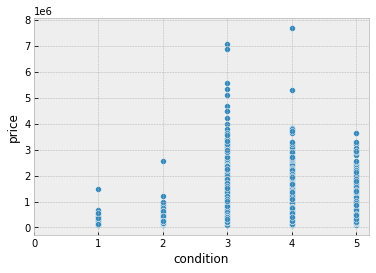

In [12]:
# Explore condition values
display(df['condition'].value_counts())
sns.scatterplot(data=df, x='condition', y='price')
plt.xticks(ticks=range(6))
plt.show();

In [13]:
# Change condition category to poor, average, and excellent to avoid multicollinearity 
df['condition'].replace(to_replace=[1, 2], value='Poor', inplace=True)
df['condition'].replace(to_replace=[3, 4], value='Average', inplace=True)
df['condition'].replace(to_replace=5, value='Excellent', inplace=True)
df['condition']

0          Average
1          Average
2          Average
3        Excellent
4          Average
           ...    
21592      Average
21593      Average
21594      Average
21595      Average
21596      Average
Name: condition, Length: 21597, dtype: object

7     8974
8     6065
9     2615
6     2038
10    1134
11     399
5      242
12      89
4       27
13      13
3        1
Name: grade, dtype: int64

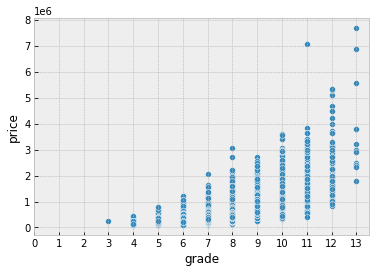

In [14]:
# Explore grade values
display(df['grade'].value_counts())
sns.scatterplot(data=df, x='grade', y='price', )
plt.xticks(ticks=range(14))
plt.show();

In [15]:
# # Change data type for all categorical columns; store ID as object to avoid mathematical errors
# for col in columns_cat:
#     df[col] = df[col].astype('category')
# df['id'] = df['id'].astype(object)
# df.info()

In [16]:
# Remove bedroom outlier
df = df[df['bedrooms'] != 33]

# Explore

* Create visualizations
* Check for collinearity
* Check that dataset meets linear regression assumptions
* After initial exploration, one-hot encode categorical data


## Zipcode

In [17]:
zipcodes_df = df.groupby('zipcode').mean().reset_index().drop(columns=['neighboring_sqft_living', 
                                                  'neighboring_sqft_lot', 'year_sold',
                                                 'age_at_sale', 'yrs_since_renovated', 'yr_renovated'])
int_cols = ['price', 'sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'yr_built']
zipcodes_df[int_cols] = zipcodes_df[int_cols].astype(int)
zipcodes_df

,zipcode,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,grade,sqft_above,sqft_basement,yr_built,lat,long
0,98001,4.651274e+09,281194,3.393352,2.011773,1903,14967,1.430748,7.296399,1723,180,1980,47.309106,-122.270704
1,98002,4.850894e+09,234284,3.326633,1.839196,1627,7517,1.334171,6.693467,1522,105,1967,47.308780,-122.213357
2,98003,4.674182e+09,294111,3.357143,2.047321,1928,10603,1.310714,7.542857,1663,259,1976,47.315741,-122.310054
3,98004,4.394237e+09,1356523,3.854890,2.527603,2909,13104,1.432177,8.687697,2419,489,1971,47.616183,-122.205189
4,98005,4.961872e+09,810289,3.851190,2.424107,2656,19928,1.279762,8.488095,2160,485,1969,47.611532,-122.167268
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,98177,3.934998e+09,676419,3.396078,2.100000,2323,11904,1.276471,7.976471,1836,473,1960,47.742381,-122.369282
66,98178,4.291467e+09,310612,3.305344,1.731870,1729,8309,1.185115,6.816794,1325,396,1955,47.499118,-122.246969
67,98188,4.481851e+09,289078,3.433824,1.863971,1802,10126,1.227941,7.036765,1492,301,1965,47.447310,-122.280993
68,98198,5.152291e+09,302896,3.182143,1.788393,1745,10525,1.225000,7.103571,1476,261,1966,47.390788,-122.315743


In [89]:
# code source: https://towardsdatascience.com/visualizing-data-at-the-zip-code-level-with-folium-d07ac983db20
# geojson file source: https://data.seattle.gov/dataset/Zip-Codes/dk58-w4ct
import json
with open('data/kc_zipcode_map.geojson', 'r') as jsonFile:
    kczipcodes = json.load(jsonFile)

geozips = []
for i in range(len(kczipcodes['features'])):
    if kczipcodes['features'][i]['properties']['ZIP'] in list(zipcodes_df['zipcode'].unique()):
        geozips.append(kczipcodes['features'][i])

new_json = dict.fromkeys(['type', 'features'])
new_json['type'] = 'FeatureCollection'
new_json['features'] = geozips

open('data/updated_kc_zipcode_map.json', 'w').write(
        json.dumps(new_json, sort_keys=True, indent=4, separators=(',', ': ')));

In [19]:
import folium

def create_map(data, zips_col, mapped_feature):
    """
    data = pd.DataFrame, main dataset to read from
    zips_col = string, column name where zipcodes are
    mapped_feature = string, column name for feature to visualize
    """
    
    kc_geo = r'data/updated_kc_zipcode_map.json'
    m = folium.Map(location = [47.47, -121.84], zoom_start=9)
    folium.Choropleth(geo_data=kc_geo, data=data, key_on='feature.properties.ZIP', highlight=True,
                columns=[zips_col, mapped_feature], fill_color='OrRd', fill_opacity=0.8, line_opacity=0.5,
                legend_name=('Average Home ' + mapped_feature.title() + ' ' + 'in King County, WA')
                     ).add_to(m)
    folium.LayerControl().add_to(m)    
    return m


In [95]:
type(kczipcodes)

dict

In [99]:
kczipcodes['features']['properties']

[{'type': 'Feature',
  'properties': {'OBJECTID': 1,
   'ZIP': 98031,
   'ZIPCODE': '98031',
   'COUNTY': '033',
   'SHAPE_Length': 117508.21171773598,
   'SHAPE_Area': 228012909.32990217},
  'geometry': {'type': 'Polygon',
   'coordinates': [[[-122.21842289674088, 47.437503648596795],
     [-122.21896085798723, 47.43750323467437],
     [-122.21957512310345, 47.43750274754203],
     [-122.22159770707769, 47.43750114891263],
     [-122.22159948023497, 47.43495688786757],
     [-122.22170516151417, 47.43495715523315],
     [-122.22360892800278, 47.434961994316446],
     [-122.22373457127979, 47.434962099304876],
     [-122.22587769127573, 47.434963881291935],
     [-122.22612385037388, 47.43508413516542],
     [-122.22618863127923, 47.43511744801654],
     [-122.22628847403791, 47.43516579242339],
     [-122.2262886113923, 47.43516566719561],
     [-122.22648870399131, 47.43497890626116],
     [-122.22661342094158, 47.43486319441269],
     [-122.22671888296699, 47.434764385764986],
     

In [111]:
with open('data/kc_zipcode_map.geojson', 'r') as f:
    geo_kc = json.load(f)
    
found = []
missing = []
kc_zips = []
    
fig = px.choropleth(zipcodes_df, locations='zipcode', scope='usa',
                    geojson=updated_zips_json, featureidkey='properties.ZIP')
fig.update_layout(margin={'r':0,'t':0,'l':0,'b':0})
fig.show()

In [20]:
kc_zipmap = create_map(zipcodes_df, 'zipcode', 'price')
kc_zipmap

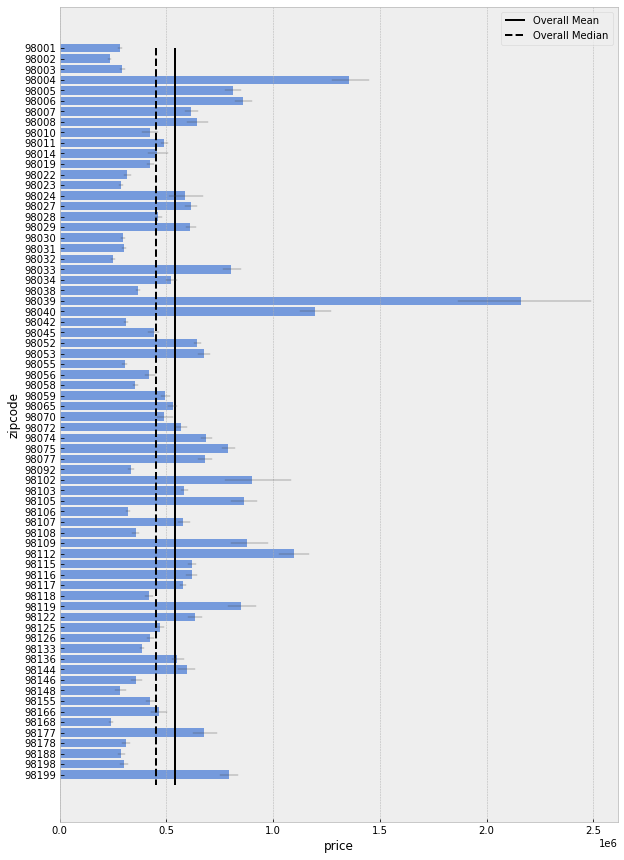

In [21]:
fig = plt.figure(figsize=(10,15))
sns.barplot(data=df, y='zipcode', x='price', orient='h', color='cornflowerblue', errwidth=.4)
plt.vlines(x=df['price'].mean(), ymin=0, ymax=70, color='black', label='Overall Mean')
plt.vlines(x=df['price'].median(), ymin=0, ymax=70, color='black', linestyles='dashed', label='Overall Median')
plt.legend();

## Multicollinearity

In [22]:
def multicollinearity(data, min_correlation=0.75, figsize=(12,10), annot=True):
    import seaborn as sns
    
    df = data.corr().abs().stack().reset_index().sort_values(0, ascending=False)
    df['pairs'] = list(zip(df.level_0, df.level_1))
    df = df.set_index('pairs').drop(columns=['level_0', 'level_1'])
    df.columns = ['correlation']
    df.drop_duplicates(inplace=True)
    
    mask = np.triu(np.ones_like(data.corr(), dtype=bool))
    cmap = sns.diverging_palette(240, 0, sep=60, s=75, as_cmap=True)
    f, ax = plt.subplots(figsize=figsize)
    sns.heatmap(data.corr().abs(), center=0, linewidths=.3, mask=mask, annot=annot, 
                cmap=cmap, square=True)
    return df[df.correlation > min_correlation] #looking for variables with corr coeff > .75


,correlation
pairs,
"(id, id)",1.000000
"(yr_renovated, yrs_since_renovated)",0.999966
"(yr_built, age_at_sale)",0.999873
"(sqft_living, sqft_above)",0.876448
"(grade, sqft_living)",0.762776
"(sqft_living, neighboring_sqft_living)",0.756400
"(grade, sqft_above)",0.756069
"(bathrooms, sqft_living)",0.755755


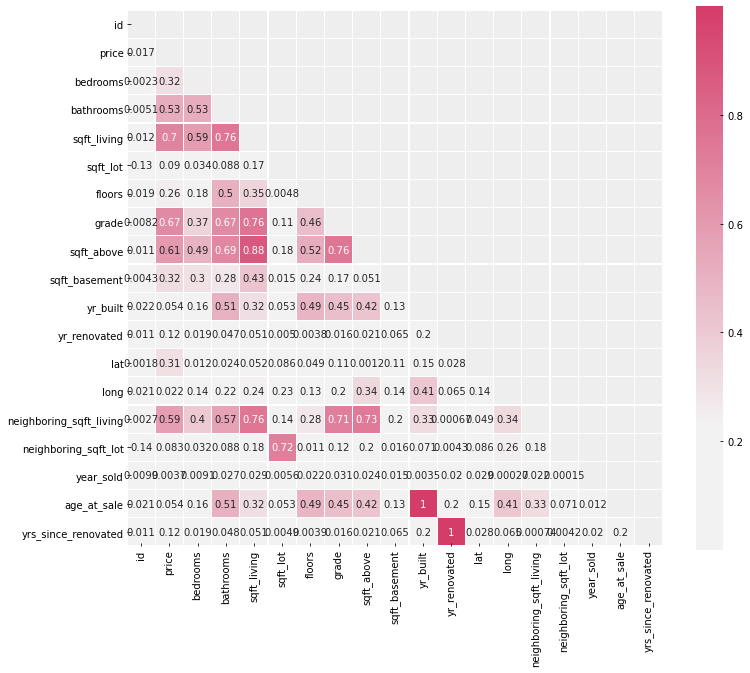

In [23]:
multicollinearity(df)

In [24]:
df_simplified = df.drop(columns=['yrs_since_renovated', 'age_at_sale', 'sqft_living', 'grade',
                                'lat', 'long', 'year_sold', 'renovated?', 'view', 'date_sold'])
df_simplified.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21596 entries, 0 to 21596
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       21596 non-null  int64  
 1   price                    21596 non-null  float64
 2   bedrooms                 21596 non-null  int64  
 3   bathrooms                21596 non-null  float64
 4   sqft_lot                 21596 non-null  int64  
 5   floors                   21596 non-null  float64
 6   waterfront               21596 non-null  object 
 7   condition                21596 non-null  object 
 8   sqft_above               21596 non-null  int64  
 9   sqft_basement            21596 non-null  float64
 10  yr_built                 21596 non-null  int64  
 11  yr_renovated             21596 non-null  float64
 12  zipcode                  21596 non-null  object 
 13  neighboring_sqft_living  21596 non-null  int64  
 14  neighboring_sqft_lot  

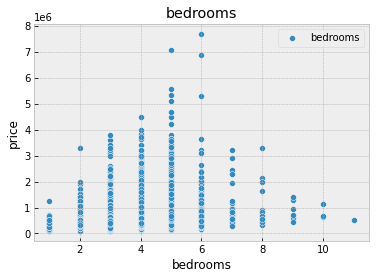

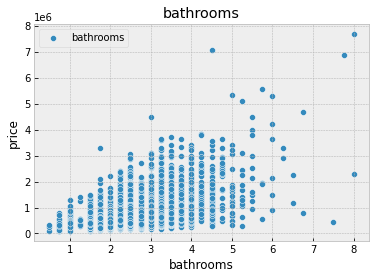

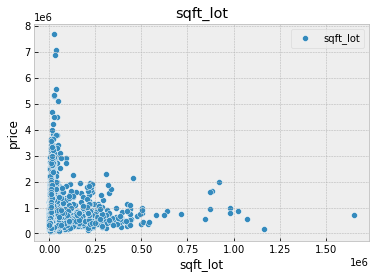

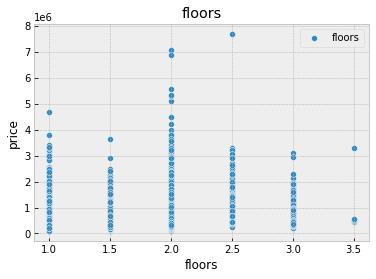

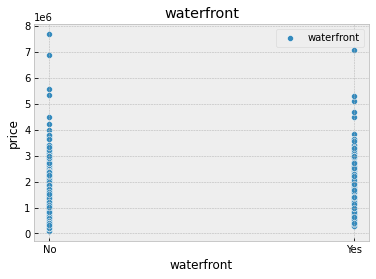

...

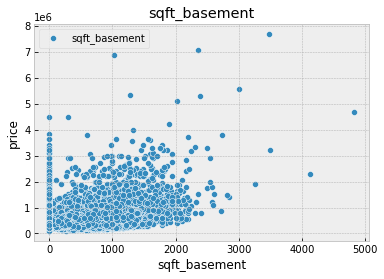

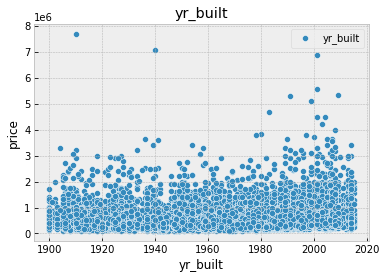

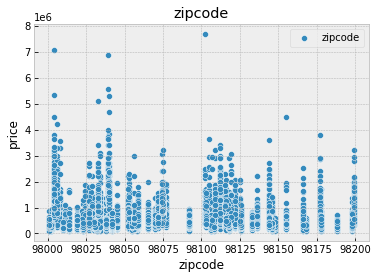

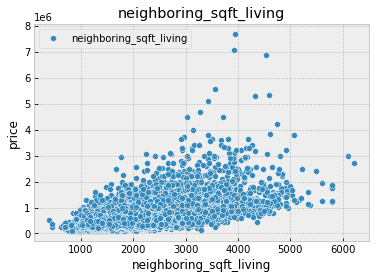

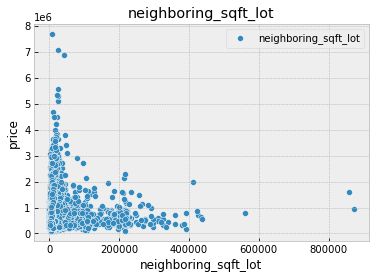

In [25]:
for col in df_simplified.drop(columns=['id', 'price', 'yr_renovated']).columns:
    sns.scatterplot(data=df_simplified, x=col, y=target, label=col)
    plt.title(col)
    plt.show()

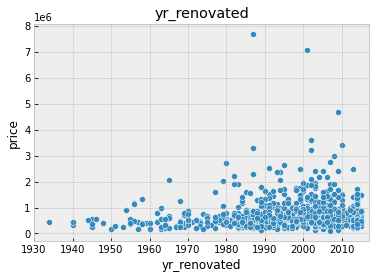

In [26]:
sns.scatterplot(data=df, x='yr_renovated', y='price')
plt.xlim(left=1930, right=2017)
plt.title('yr_renovated');

# Model

Workflow:
1. Define dependent variable column, store column name as a string "target"
1. Create baseline dataframe "df"
1. Identify categorical columns and columns to drop from model, put both into lists "columns_cat", "drop_cols"
1. One-hot encode categorical columns to create "df_ohe"
1. Model using "df_ohe" and "target"
1. Interpret results:
    1. R2 should be adequate
    1. Residuals should be normally distributed (qq plot)
    1. Residuals should be homoskedastic (scatterplot of residuals)
Repeat until R2 and 

In [27]:
def onehotencode(df, columns_cat, drop_cols=[]):
    '''
    Parameters:
    df = pd.dataframe to model
    columns_cat = list of categorical columns to one-hot encode
    drop_cols = (optional) any columns from overall df to drop before one-hot encoding
    
    Returns:
    Dataframe with categorical columns one-hot encoded, original columns + specificied columns dropped, 
    and column names with periods replaced with underscores
    '''
    df_ohe = pd.get_dummies(df.drop(columns=drop_cols), columns=columns_cat, drop_first=True)
    new_cols = []
    for col in df_ohe.columns:
        new_cols.append(col.replace('.', '_'))
    df_ohe.columns = new_cols
    return df_ohe

In [28]:
def model(df, target):
    '''
    Parameters:
    df = pd.dataframe, with categorical variables one-hot encoded
    target = string, column name of dependent variable
    exclude_cols = list, columns to exclude from model, due to multicollinearity, etc.
    
    Returns:
    Model summary
    QQ plot (to check that residuals are normally distributed)
    Scatter plot of residuals (to check that residuals are homoskedastic)
    '''
    formula_predictors = ' + '.join(df.drop(columns=target).columns)
    formula = target + ' ~ ' + formula_predictors
    model = ols(formula=formula, data=df).fit()
    display(model.summary())
    
    fig, ax = plt.subplots(ncols=2, figsize=(10,5))
    sm.graphics.qqplot(data=model.resid, fit=True, line='45', ax=ax[0], )
    ax[0].set_title('QQ Plot -\n check for normally distributed residuals')
    ax[1].scatter(model.predict(df), model.resid)
    ax[1].axhline(y=0, color='black')
    ax[1].set_title('Scatterplot of Errors -\n check for homoskedasticity')
    plt.tight_layout()
    plt.show();
    
    return model

    

## Model 1

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.788
Model:                            OLS   Adj. R-squared:                  0.787
Method:                 Least Squares   F-statistic:                     928.3
Date:                Thu, 15 Apr 2021   Prob (F-statistic):               0.00
Time:                        16:50:18   Log-Likelihood:            -2.9064e+05
No. Observations:               21596   AIC:                         5.815e+05
Df Residuals:                   21509   BIC:                         5.821e+05
Df Model:                          86                                         
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Intercept                6.055e+05   1.33e+05      4.546      0.000    3.44e+05    8.67e+05
bedrooms                -3.886e+04   1683.340    -23.082      0.000   -4.22e+04   -3.56e+04
bathrooms                3.607e+04   2771.567     13.015      0.000    3.06e+04    4.15e+04
sqft_lot                    0.3040      0.041      7.496      0.000       0.225       0.383
sqft_above                250.7023      2.931     85.531      0.000     244.957     256.448
sqft_basement             162.9856      3.645     44.720      0.000     155.842     170.129
yr_built                 -408.3136     67.689     -6.032      0.000    -540.989    -275.638
yr_renovated               22.4650      3.353      6.700      0.000      15.893      29.037
neighboring_sqft_living    55.3672      2.892     19.144      0.000      49.698      61.036
neighboring_sqft_lot       -0.1716      0.064     -2.690      0.007      -0.297      -0.047
floors_1_5              -2.734e+04   4671.381     -5.853      0.000   -3.65e+04   -1.82e+04
floors_2_0              -5.827e+04   3881.290    -15.013      0.000   -6.59e+04   -5.07e+04
floors_2_5               4.933e+04   1.41e+04      3.497      0.000    2.17e+04     7.7e+04
floors_3_0              -6.938e+04   8685.103     -7.988      0.000   -8.64e+04   -5.24e+04
floors_3_5               3.923e+04   6.44e+04      0.609      0.542    -8.7e+04    1.65e+05
waterfront_Yes           8.647e+05   1.46e+04     59.389      0.000    8.36e+05    8.93e+05
condition_Excellent      5.172e+04   4533.413     11.409      0.000    4.28e+04    6.06e+04
condition_Poor          -2.834e+04   1.22e+04     -2.320      0.020   -5.23e+04   -4398.528
zipcode_98002            2.566e+04    1.5e+04      1.710      0.087   -3753.218    5.51e+04
zipcode_98003            4605.9987   1.35e+04      0.341      0.733   -2.19e+04    3.11e+04
zipcode_98004            7.934e+05   1.32e+04     59.970      0.000    7.68e+05    8.19e+05
zipcode_98005            3.145e+05    1.6e+04     19.710      0.000    2.83e+05    3.46e+05
zipcode_98006            3.045e+05   1.19e+04     25.524      0.000    2.81e+05    3.28e+05
zipcode_98007            2.659e+05   1.69e+04     15.751      0.000    2.33e+05    2.99e+05
zipcode_98008             2.78e+05   1.35e+04     20.543      0.000    2.51e+05    3.04e+05
zipcode_98010            5.358e+04   1.93e+04      2.781      0.005    1.58e+04    9.13e+04
zipcode_98011            1.118e+05   1.51e+04      7.404      0.000    8.22e+04    1.41e+05
zipcode_98014            8.763e+04    1.8e+04      4.879      0.000    5.24e+04    1.23e+05
zipcode_98019            6.655e+04   1.53e+04      4.355      0.000    3.66e+04    9.65e+04
zipcode_98022            1.027e+04   1.44e+04      0.712      0.477    -1.8e+04    3.85e+04
zipcode_98023           -2.288e+04   1.17e+04  

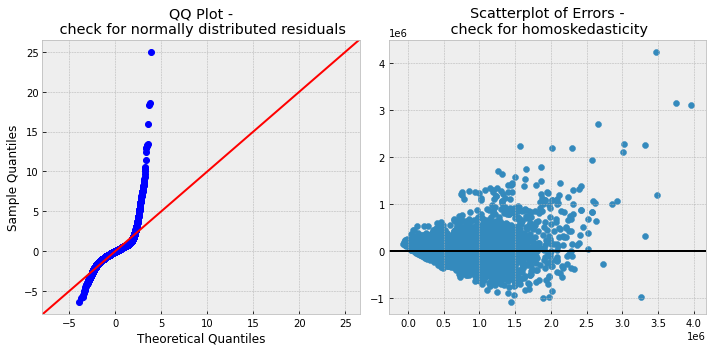

In [29]:
# identify df
df_simplified.head()

# Identify categorical columns
m1_columns_cat = ['floors', 'waterfront', 'condition', 'zipcode']
m1_drop_cols = ['id']

# one-hot encode categorical columns
m1_df_ohe = onehotencode(df=df_simplified, columns_cat=m1_columns_cat, drop_cols=m1_drop_cols)
m1_df_ohe.head()

# model
model1 = model(df=m1_df_ohe, target=target)
model1

## Model 2

Removed outliers in price and lot size

In [30]:
def plot_iqr(df, col, title=None, marker_height=930, line_height=900):
    '''
    Parameters:
    df = pd.dataframe, main data source
    col = column name to plot (x axis)
    title = title for graph
    marker_height = int, where to place marker; depends on the highest bin count in dataset (default is 930)
    line_height = int, where to end vertical line markers; depends on the highest bin count in dataset (default is 900)
    
    Returns:
    Histogram with marginal box plot, markers and labels at max fence and min fence 
    to show where there are outliers in your dataset
    
    '''
    # Calculating min, max, Q1, and Q3 interquartile ranges on price column to locate outliers
    iqr = stats.iqr(df[col])
    q1 = np.quantile(a=df[col], q=.25)
    minimum = q1-1.5*iqr
    q3 = np.quantile(a=df[col], q=.75)
    maximum = q3+1.5*iqr

    if minimum < df[col].min():
        min_fence = df[col].min()
    else:
        min_fence = minimum

    if maximum > df[col].max():
        max_fence = df[col].max()
    else:
        max_fence = maximum

    min_fence_str = '{:,}'.format(int(min_fence))
    max_fence_str = '{:,}'.format(int(max_fence))

    # Visualize distribution of target, showing outliers on the high end
    fig = px.histogram(df, x=df[col], marginal='box',
                        title=title)
    fig.update_layout(plot_bgcolor='#f2f2f2', bargap=0.1, height=500, title_font_size=18, font_size=12)

    # max marker
    fig.add_trace(go.Scatter(x=np.array(max_fence), y=np.array(marker_height), text=max_fence_str, mode='text',
                             name=('Max Fence: {}'.format(max_fence_str))))
    fig.add_shape(type='line', x0=max_fence, y0=0, x1=max_fence, y1=line_height)
    # min marker
    fig.add_trace(go.Scatter(x=np.array(min_fence), y=np.array(marker_height), text=(min_fence_str), mode='text',
                             name=('Min Fence: {}'.format(min_fence_str))))
    fig.add_shape(type='line', x0=min_fence, y0=0, x1=min_fence, y1=line_height)

    fig.show()
    print('Min: ', df[col].min(), 'Max: ', df[col].max())


In [31]:
title = 'King County Home Price Distribution (Sales May 2014-May 2015)'
plot_iqr(df_simplified, target, title=title)

Min:  78000.0 Max:  7700000.0


In [34]:
df_outliers_removed = df_simplified[df_simplified.price < 1129500]

,id,price,bedrooms,bathrooms,sqft_lot,floors,waterfront,condition,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,neighboring_sqft_living,neighboring_sqft_lot
0,7129300520,221900.0,3,1.00,5650,1.0,No,Average,1180,0.0,1955,0.0,98178,1340,5650
1,6414100192,538000.0,3,2.25,7242,2.0,No,Average,2170,400.0,1951,1991.0,98125,1690,7639
2,5631500400,180000.0,2,1.00,10000,1.0,No,Average,770,0.0,1933,0.0,98028,2720,8062
3,2487200875,604000.0,4,3.00,5000,1.0,No,Excellent,1050,910.0,1965,0.0,98136,1360,5000
4,1954400510,510000.0,3,2.00,8080,1.0,No,Average,1680,0.0,1987,0.0,98074,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,263000018,360000.0,3,2.50,1131,3.0,No,Average,1530,0.0,2009,0.0,98103,1530,1509
21593,6600060120,400000.0,4,2.50,5813,2.0,No,Average,2310,0.0,2014,0.0,98146,1830,7200
21594,1523300141,402101.0,2,0.75,1350,2.0,No,Average,1020,0.0,2009,0.0,98144,1020,2007
21595,291310100,400000.0,3,2.50,2388,2.0,No,Average,1600,0.0,2004,0.0,98027,1410,1287


In [35]:
plot_iqr(df_outliers_removed, target, title=title, marker_height=540, line_height=510)

Min:  78000.0 Max:  1120000.0


In [51]:
plot_iqr(df_outliers_removed, col='sqft_lot', title='King County Home Lot Size Distribution',
        marker_height=820, line_height=800)

Min:  520 Max:  18265


In [37]:
df_outliers_removed = df_outliers_removed[df_outliers_removed['sqft_lot'] < 18291]

In [38]:
plot_iqr(df_outliers_removed, col='sqft_lot')

Min:  520 Max:  18265


In [39]:
plot_iqr(df_outliers_removed, col='sqft_above', title='King County Home Size Distribution (excluding basement)')

Min:  370 Max:  5370


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.816
Model:                            OLS   Adj. R-squared:                  0.815
Method:                 Least Squares   F-statistic:                     935.3
Date:                Thu, 15 Apr 2021   Prob (F-statistic):               0.00
Time:                        16:50:49   Log-Likelihood:            -2.3312e+05
No. Observations:               18214   AIC:                         4.664e+05
Df Residuals:                   18127   BIC:                         4.671e+05
Df Model:                          86                                         
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Intercept                1.912e+05   7.82e+04      2.447      0.014     3.8e+04    3.44e+05
bedrooms                -1.026e+04    995.146    -10.312      0.000   -1.22e+04   -8311.529
bathrooms                 1.85e+04   1625.180     11.385      0.000    1.53e+04    2.17e+04
sqft_lot                    2.9084      0.316      9.199      0.000       2.289       3.528
sqft_above                137.1069      2.066     66.370      0.000     133.058     141.156
sqft_basement              91.8851      2.342     39.238      0.000      87.295      96.475
yr_built                 -155.4992     39.590     -3.928      0.000    -233.099     -77.900
yr_renovated               20.1731      2.025      9.964      0.000      16.205      24.142
neighboring_sqft_living    60.6253      1.886     32.138      0.000      56.928      64.323
neighboring_sqft_lot       -0.0901      0.222     -0.406      0.685      -0.525       0.345
floors_1_5               7518.3551   2714.154      2.770      0.006    2198.356    1.28e+04
floors_2_0              -8077.9778   2413.418     -3.347      0.001   -1.28e+04   -3347.450
floors_2_5              -1.033e+04   9352.269     -1.105      0.269   -2.87e+04    7996.678
floors_3_0                -3.1e+04   4896.566     -6.332      0.000   -4.06e+04   -2.14e+04
floors_3_5              -3.654e+04   3.61e+04     -1.013      0.311   -1.07e+05    3.41e+04
waterfront_Yes           3.292e+05   1.77e+04     18.594      0.000    2.94e+05    3.64e+05
condition_Excellent      4.419e+04   2556.139     17.287      0.000    3.92e+04    4.92e+04
condition_Poor          -5.802e+04   7209.739     -8.048      0.000   -7.22e+04   -4.39e+04
zipcode_98002            1.595e+04   8117.534      1.965      0.049      37.156    3.19e+04
zipcode_98003            1.618e+04   7416.053      2.181      0.029    1641.222    3.07e+04
zipcode_98004            5.271e+05   9069.428     58.116      0.000    5.09e+05    5.45e+05
zipcode_98005            3.522e+05   9847.563     35.760      0.000    3.33e+05    3.71e+05
zipcode_98006             3.02e+05   6929.303     43.578      0.000    2.88e+05    3.16e+05
zipcode_98007            2.765e+05   9206.256     30.029      0.000    2.58e+05    2.94e+05
zipcode_98008            2.677e+05   7531.336     35.550      0.000    2.53e+05    2.83e+05
zipcode_98010            8.594e+04   1.39e+04      6.173      0.000    5.87e+04    1.13e+05
zipcode_98011            1.457e+05   8270.943     17.616      0.000    1.29e+05    1.62e+05
zipcode_98014            1.044e+05   1.38e+04      7.541      0.000    7.73e+04    1.32e+05
zipcode_98019            7.871e+04   8956.666      8.788      0.000    6.12e+04    9.63e+04
zipcode_98022            1.473e+04   8877.911      1.659      0.097   -2675.173    3.21e+04
zipcode_98023           -4109.1718   6524.001  

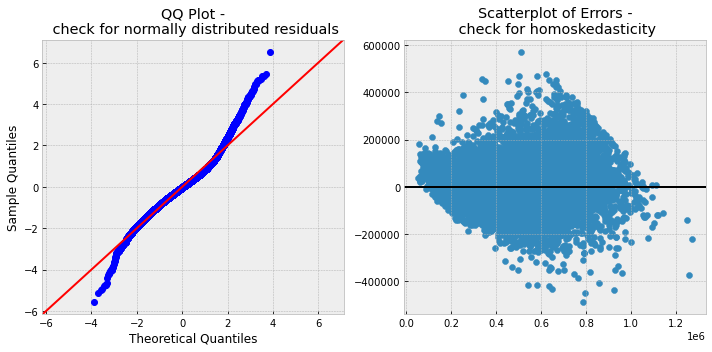

In [40]:
# identify df
df_outliers_removed.head()

# Identify categorical columns
m2_columns_cat = ['floors', 'waterfront', 'condition', 'zipcode']
m2_drop_cols = ['id']

# one-hot encode categorical columns
m2_df_ohe = onehotencode(df=df_outliers_removed, columns_cat=m2_columns_cat, drop_cols=m2_drop_cols)
m2_df_ohe.head()

# model
model2 = model(df=m2_df_ohe, target=target)
model2

## Model 3

Removed features with poor p-values: floors, neighboring sqft lot

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.816
Model:                            OLS   Adj. R-squared:                  0.815
Method:                 Least Squares   F-statistic:                     1002.
Date:                Thu, 15 Apr 2021   Prob (F-statistic):               0.00
Time:                        16:50:50   Log-Likelihood:            -2.3315e+05
No. Observations:               18214   AIC:                         4.665e+05
Df Residuals:                   18133   BIC:                         4.671e+05
Df Model:                          80                                         
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Intercept                4.593e+05   6.84e+04      6.712      0.000    3.25e+05    5.93e+05
bedrooms                -9530.3203    986.991     -9.656      0.000   -1.15e+04   -7595.725
bathrooms                1.689e+04   1583.521     10.665      0.000    1.38e+04       2e+04
sqft_lot                    3.0664      0.262     11.713      0.000       2.553       3.580
sqft_above                135.6220      1.929     70.301      0.000     131.841     139.403
sqft_basement              94.2537      2.256     41.771      0.000      89.831      98.677
yr_built                 -292.5541     34.586     -8.459      0.000    -360.347    -224.761
yr_renovated               18.9193      2.016      9.385      0.000      14.968      22.871
neighboring_sqft_living    61.2792      1.876     32.663      0.000      57.602      64.957
waterfront_Yes           3.252e+05   1.77e+04     18.359      0.000     2.9e+05     3.6e+05
condition_Excellent      4.431e+04   2558.597     17.319      0.000    3.93e+04    4.93e+04
condition_Poor          -5.894e+04   7215.039     -8.169      0.000   -7.31e+04   -4.48e+04
zipcode_98002            1.572e+04   8126.445      1.934      0.053    -208.710    3.16e+04
zipcode_98003            1.612e+04   7423.938      2.171      0.030    1567.023    3.07e+04
zipcode_98004             5.24e+05   9067.238     57.790      0.000    5.06e+05    5.42e+05
zipcode_98005            3.513e+05   9849.463     35.669      0.000    3.32e+05    3.71e+05
zipcode_98006            3.003e+05   6933.695     43.313      0.000    2.87e+05    3.14e+05
zipcode_98007            2.745e+05   9212.794     29.798      0.000    2.56e+05    2.93e+05
zipcode_98008            2.667e+05   7527.317     35.436      0.000    2.52e+05    2.81e+05
zipcode_98010            8.493e+04   1.39e+04      6.093      0.000    5.76e+04    1.12e+05
zipcode_98011            1.454e+05   8280.952     17.563      0.000    1.29e+05    1.62e+05
zipcode_98014            1.045e+05   1.38e+04      7.556      0.000    7.74e+04    1.32e+05
zipcode_98019            7.848e+04   8961.649      8.757      0.000    6.09e+04     9.6e+04
zipcode_98022            1.552e+04   8885.641      1.747      0.081   -1896.258    3.29e+04
zipcode_98023           -3932.8920   6529.339     -0.602      0.547   -1.67e+04    8865.232
zipcode_98024             1.31e+05    1.8e+04      7.278      0.000    9.57e+04    1.66e+05
zipcode_98027            2.439e+05   7564.824     32.244      0.000    2.29e+05    2.59e+05
zipcode_98028            1.392e+05   7524.969     18.498      0.000    1.24e+05    1.54e+05
zipcode_98029            2.555e+05   7277.874     35.110      0.000    2.41e+05     2.7e+05
zipcode_98030            9075.0367   7605.209      1.193      0.233   -5831.894     2.4e+04
zipcode_98031            1.901e+04   7532.476  

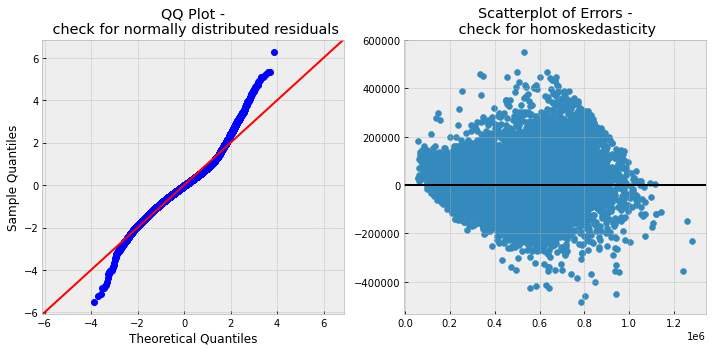

In [41]:
# identify df
df_outliers_removed.head()

# Identify categorical columns
m3_columns_cat = ['waterfront', 'condition', 'zipcode']
m3_drop_cols = ['id', 'floors', 'neighboring_sqft_lot']

# one-hot encode categorical columns
m3_df_ohe = onehotencode(df=df_outliers_removed, columns_cat=m3_columns_cat, drop_cols=m3_drop_cols)
m3_df_ohe.head()

# model
model3 = model(df=m3_df_ohe, target=target)
model3

## Model 4

Still seeing some weirdness in residuals. Removed zipcode feature to see what affect it has on the model.

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.489
Model:                            OLS   Adj. R-squared:                  0.488
Method:                 Least Squares   F-statistic:                     1581.
Date:                Thu, 15 Apr 2021   Prob (F-statistic):               0.00
Time:                        16:50:50   Log-Likelihood:            -2.4243e+05
No. Observations:               18214   AIC:                         4.849e+05
Df Residuals:                   18202   BIC:                         4.850e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
===========================================================================================
                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------
Intercept                4.354e+06    9.6e+04     45.375      0.000    4.17e+06    4.54e+06
bedrooms                -2.652e+04   1606.415    -16.506      0.000   -2.97e+04   -2.34e+04
bathrooms                4.368e+04   2590.957     16.857      0.000    3.86e+04    4.88e+04
sqft_lot                  -10.8972      0.340    -32.033      0.000     -11.564     -10.230
sqft_above                137.5274      3.156     43.574      0.000     131.341     143.714
sqft_basement             129.5625      3.648     35.511      0.000     122.411     136.714
yr_built                -2169.4916     49.643    -43.702      0.000   -2266.796   -2072.187
yr_renovated               14.4726      3.333      4.343      0.000       7.940      21.005
neighboring_sqft_living   107.9019      2.925     36.885      0.000     102.168     113.636
waterfront_Yes            2.49e+05   2.87e+04      8.665      0.000    1.93e+05    3.05e+05
condition_Excellent      3.525e+04   4198.797      8.396      0.000     2.7e+04    4.35e+04
condition_Poor          -7.807e+04   1.19e+04     -6.541      0.000   -1.01e+05   -5.47e+04
==============================================================================
Omnibus:                      691.432   Durbin-Watson:                   1.974
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              810.210
Skew:                           0.454   Prob(JB):                    1.16e-176
Kurtosis:                       3.495   Cond. No.                     7.57e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 7.57e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

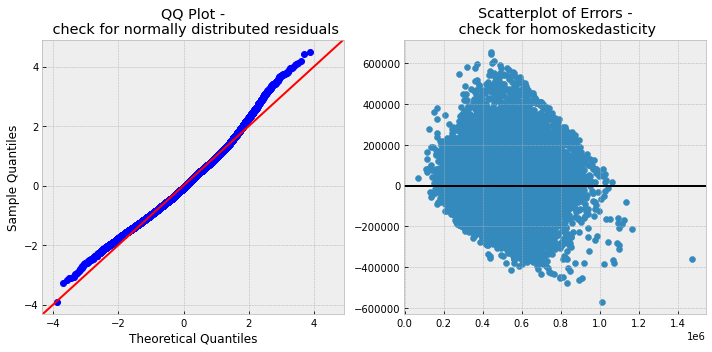

In [42]:
# identify df
df_outliers_removed.head()

# Identify categorical columns
m4_columns_cat = ['waterfront', 'condition']
m4_drop_cols = ['id', 'floors', 'neighboring_sqft_lot', 'zipcode']

# one-hot encode categorical columns
m4_df_ohe = onehotencode(df=df_outliers_removed, columns_cat=m4_columns_cat, drop_cols=m4_drop_cols)
m4_df_ohe.head()

# model
model4 = model(df=m4_df_ohe, target=target)
model4

## Model 5

While residuals look much more normal, model 4's R2 went way down. Now trying recursive feature elimination to identify which features to keep. Picked: bathrooms, waterfront, condition, zipcode.

In [43]:
# recursive feature elimination
def rfe(df, target, number=4):
    '''
    Parameters:
    df - pd.DataFrame, main dataframe to read from
    target - str, name of target column
    number - int, number of features to select
    
    '''
    from sklearn.feature_selection import RFE
    from sklearn.linear_model import LinearRegression

    linreg = LinearRegression()
    selector = RFE(linreg, n_features_to_select=number)
    selector = selector.fit(df.drop(columns=[target]), df[target])
    features = dict(zip(df.drop(columns=[target]).columns, selector.support_))
    return dict(sorted(features.items(), key=lambda x: x[1], reverse=True))

In [44]:
rfe(m3_df_ohe, target)

{'zipcode_98004': True,
 'zipcode_98039': True,
 'zipcode_98040': True,
 'zipcode_98075': True,
 'bedrooms': False,
 'bathrooms': False,
 'sqft_lot': False,
 'sqft_above': False,
 'sqft_basement': False,
 'yr_built': False,
 'yr_renovated': False,
 'neighboring_sqft_living': False,
 'waterfront_Yes': False,
 'condition_Excellent': False,
 'condition_Poor': False,
 'zipcode_98002': False,
 'zipcode_98003': False,
 'zipcode_98005': False,
 'zipcode_98006': False,
 'zipcode_98007': False,
 'zipcode_98008': False,
 'zipcode_98010': False,
 'zipcode_98011': False,
 'zipcode_98014': False,
 'zipcode_98019': False,
 'zipcode_98022': False,
 'zipcode_98023': False,
 'zipcode_98024': False,
 'zipcode_98027': False,
 'zipcode_98028': False,
 'zipcode_98029': False,
 'zipcode_98030': False,
 'zipcode_98031': False,
 'zipcode_98032': False,
 'zipcode_98033': False,
 'zipcode_98034': False,
 'zipcode_98038': False,
 'zipcode_98042': False,
 'zipcode_98045': False,
 'zipcode_98052': False,
 'zipcode

In [45]:
rfe(m4_df_ohe, target)

{'bathrooms': True,
 'waterfront_Yes': True,
 'condition_Excellent': True,
 'condition_Poor': True,
 'bedrooms': False,
 'sqft_lot': False,
 'sqft_above': False,
 'sqft_basement': False,
 'yr_built': False,
 'yr_renovated': False,
 'neighboring_sqft_living': False}

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.654
Model:                            OLS   Adj. R-squared:                  0.653
Method:                 Least Squares   F-statistic:                     464.0
Date:                Thu, 15 Apr 2021   Prob (F-statistic):               0.00
Time:                        16:50:56   Log-Likelihood:            -2.3887e+05
No. Observations:               18214   AIC:                         4.779e+05
Df Residuals:                   18139   BIC:                         4.785e+05
Df Model:                          74                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept             3.77e+04   7673.487      4.913      0.000    2.27e+04    5.27e+04
id                   5.503e-07   3.23e-07      1.703      0.089   -8.32e-08    1.18e-06
bathrooms             1.11e+05   1361.478     81.516      0.000    1.08e+05    1.14e+05
waterfront_Yes       3.553e+05   2.42e+04     14.682      0.000    3.08e+05    4.03e+05
condition_Excellent  4.028e+04   3367.736     11.961      0.000    3.37e+04    4.69e+04
condition_Poor      -7.392e+04   9850.215     -7.505      0.000   -9.32e+04   -5.46e+04
zipcode_98002       -1.488e+04   1.11e+04     -1.344      0.179   -3.66e+04    6826.954
zipcode_98003        2.278e+04   1.02e+04      2.243      0.025    2876.723    4.27e+04
zipcode_98004        5.793e+05   1.23e+04     46.965      0.000    5.55e+05    6.03e+05
zipcode_98005        4.112e+05   1.34e+04     30.612      0.000    3.85e+05    4.38e+05
zipcode_98006        3.825e+05   9408.118     40.654      0.000    3.64e+05    4.01e+05
zipcode_98007        3.087e+05   1.26e+04     24.535      0.000    2.84e+05    3.33e+05
zipcode_98008        2.857e+05   1.03e+04     27.842      0.000    2.66e+05    3.06e+05
zipcode_98010        7.415e+04   1.91e+04      3.889      0.000    3.68e+04    1.12e+05
zipcode_98011        1.908e+05   1.13e+04     16.871      0.000    1.69e+05    2.13e+05
zipcode_98014        8.859e+04   1.89e+04      4.688      0.000    5.15e+04    1.26e+05
zipcode_98019        1.074e+05   1.23e+04      8.759      0.000    8.34e+04    1.31e+05
zipcode_98022        5785.1297   1.21e+04      0.476      0.634    -1.8e+04    2.96e+04
zipcode_98023        7417.8292   8931.861      0.830      0.406   -1.01e+04    2.49e+04
zipcode_98024        1.445e+05   2.46e+04      5.874      0.000    9.63e+04    1.93e+05
zipcode_98027        2.646e+05   1.03e+04     25.680      0.000    2.44e+05    2.85e+05
zipcode_98028        1.698e+05   1.03e+04     16.517      0.000     1.5e+05     1.9e+05
zipcode_98029        2.608e+05   9870.362     26.422      0.000    2.41e+05     2.8e+05
zipcode_98030         1.08e+04   1.04e+04      1.038      0.299   -9599.060    3.12e+04
zipcode_98031        1.069e+04   1.03e+04      1.038      0.299   -9500.167    3.09e+04
zipcode_98032         1.53e+04   1.31e+04      1.164      0.244   -1.05e+04     4.1e+04
zipcode_98033        3.676e+05   9504.165     38.682      0.000    3.49e+05    3.86e+05
zipcode_98034        1.951e+05   8790.678     22.193      0.000    1.78e+05    2.12e+05
zipcode_98038        3.258e+04   8839.710      3.685      0.000    1.52e+04    4.99e+04
zipcode_98039        7.038e+05   4.96e+04     14.189      0.000    6.07e+05    8.01e+05
zipcode_98040        5.421e+05    1.2e+04     45.256      0.000    5.19e+05    5.66e+05
zipcode_98042        9977.7130   9024.554      1.106      0.269   -7711.269    2.77e+04
zip

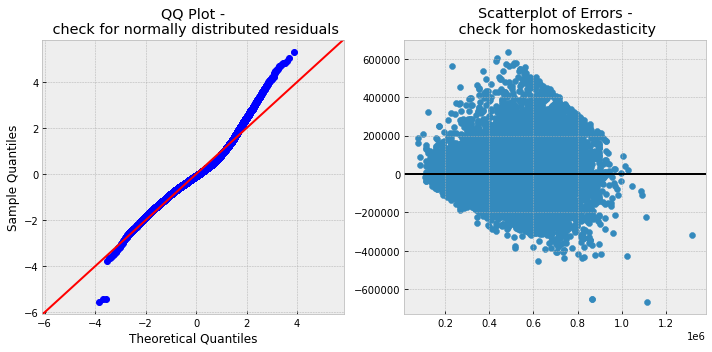

In [46]:
# identify df
features = ['bathrooms', 'waterfront', 'condition', 'zipcode']
m5_df = df_outliers_removed.drop(columns=['bedrooms', 'sqft_lot', 'floors', 'sqft_above', 'sqft_basement', 
                    'yr_built', 'yr_renovated', 'neighboring_sqft_living', 'neighboring_sqft_lot'])

# Identify categorical columns
m5_columns_cat = ['waterfront', 'condition', 'zipcode']

# one-hot encode categorical columns
m5_df_ohe = onehotencode(df=m5_df, columns_cat=m5_columns_cat)
m5_df_ohe.head()

# model
model5 = model(df=m5_df_ohe, target=target)
model5

In [55]:
# normality test... just to be sure :(
name = ['Jarque-Bera','Prob','Skew', 'Kurtosis']
test = sms.jarque_bera(model5.resid)
list(zip(name, test))

[('Jarque-Bera', 3711.464400127349),
 ('Prob', 0.0),
 ('Skew', 0.6236139394532961),
 ('Kurtosis', 4.826170715512866)]

## Model 6

See if some zipcodes are throwing off the model

,correlation
pairs,
"(id, id)",1.0


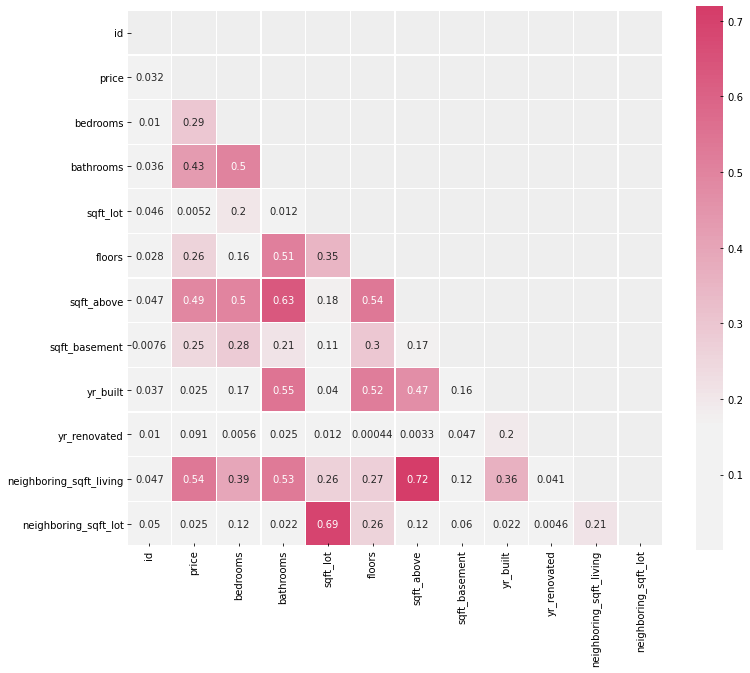

In [66]:
multicollinearity(df_outliers_removed)

# Interpret

* Define recommendations
* Create/select supporting visuals to communicate to stakeholders

# Appendix

In [47]:
# Attempting to get markers and popups on the map; can't get it to work

# code source: https://www.kaggle.com/saidakbarp/nyc-property-sales-eda-map-analysis/notebook#Map-analysis

# from folium.plugins import MarkerCluster
# marker_cluster = MarkerCluster().add_to(kc_zipmap)
# for i in zipcodes_df.iterrows():
#     folium.Marker(location=[zipcodes_df['lat'][i], zipcodes_df['long'][i]], 
#                   popup=zipcodes_df['zipcode'][i],
#                   tooltip="""Mean home price: <b>${}</b> <br>
#                            Mean sq footage (living): <b>{}</b> <br>
#                            Mean year built: <b>{}</b>""".format(zipcodes_df['price'][i], 
#                                                                 zipcodes_df['sqft_living'][i], 
#                                                                 zipcodes_df['yr_built'][i])).add_to(kc_zipmap)
    
#     from folium.plugins import MarkerCluster
#     marker_cluster = MarkerCluster() 
#     for i in range(len(data)):
#         location = [data['lat'][i],data['long'][i]]
#         tooltip = "Zipcode:{}<br> Click for more".format(data[zips][i])
#         folium.Marker(location, 
#                       popup="""<i>Mean home price: </i> <br> <b>${}</b> <br>
#                       <i>Mean square footage (living): </i><b><br>{}</b><br>
#                       <i>Mean year built: </i><b><br>{}</b><br>""".format(data['price'][i], 
#                                                                           data['sqft_living'][i], 
#                                                                           data['yr_built'][i]), 
#                       tooltip=tooltip).add_to(marker_cluster)
#     marker_cluster.add_to(m)